## Reference - https://www.kaggle.com/yamqwe/great-barrier-reef-yolox-yolov5-ensemble

In [1]:
import warnings; warnings.filterwarnings("ignore")

import os
import cv2
import ast
import sys
import glob
import torch
import shutil
import importlib
import traceback
import numpy as np
import pandas as pd
from PIL import Image
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
sys.path.append('./tensorflow-great-barrier-reef')
tqdm.pandas()

from PIL import Image
from IPython.display import display
from tqdm.notebook import tqdm
tqdm.pandas()

## YoloV5

In [2]:
ROOT_DIR  = './tensorflow-great-barrier-reef/'
CKPT_PATH_1 = './yolov5/runs/train/exp162/weights/v5m6best27.pt'
IMG_SIZE_1  = 3600
CONF_1      = 0.58
IOU_1       = 0.4
AUGMENT_1   = True

In [3]:
ROOT_DIR  = './tensorflow-great-barrier-reef/'
CKPT_PATH_2 = './yolov5/runs/train/exp165/weights/v5m6best28.pt'
IMG_SIZE_2  = 1280
CONF_2      = 0.58
IOU_2       = 0.4
AUGMENT_2   = True

In [4]:
IMG_SIZES = [IMG_SIZE_1, IMG_SIZE_2]

In [5]:
def get_path(row):
    row['image_path'] = f'{ROOT_DIR}/train_images/video_{row.video_id}/{row.video_frame}.jpg'
    return row

In [6]:
# Train Data
df = pd.read_csv(f'{ROOT_DIR}/train.csv')
df = df.progress_apply(get_path, axis=1)
df['annotations'] = df['annotations'].progress_apply(lambda x: ast.literal_eval(x))
df['num_bbox'] = df['annotations'].progress_apply(lambda x: len(x))
data = (df.num_bbox>0).value_counts()/len(df)*100

  0%|          | 0/23501 [00:00<?, ?it/s]

  0%|          | 0/23501 [00:00<?, ?it/s]

  0%|          | 0/23501 [00:00<?, ?it/s]

In [105]:
def voc2yolo(bboxes, image_height=720, image_width=1280):
    """
    voc  => [x1, y1, x2, y1]
    yolo => [xmid, ymid, w, h] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        bboxes[..., [0, 2]] = bboxes[..., [0, 2]]/ image_width
        bboxes[..., [1, 3]] = bboxes[..., [1, 3]]/ image_height
        w = bboxes[..., 2] - bboxes[..., 0]
        h = bboxes[..., 3] - bboxes[..., 1]
        bboxes[..., 0] = bboxes[..., 0] + w/2
        bboxes[..., 1] = bboxes[..., 1] + h/2
        bboxes[..., 2] = w
        bboxes[..., 3] = h
    return bboxes

def voc2normalized(bboxes, image_height=720, image_width=1280):
    """
    voc  => [x1, y1, x2, y1]
    yolo => [x1, y1, x2, y1] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        bboxes[..., [0, 2]] = bboxes[..., [0, 2]]/ image_width
        bboxes[..., [1, 3]] = bboxes[..., [1, 3]]/ image_height
    #     w = bboxes[..., 2] - bboxes[..., 0]
    #     h = bboxes[..., 3] - bboxes[..., 1]
    #     bboxes[..., 0] = bboxes[..., 0] + w/2
    #     bboxes[..., 1] = bboxes[..., 1] + h/2
    #     bboxes[..., 2] = w + bboxes[..., 0]
    #     bboxes[..., 3] = h
    return bboxes

def coco2normalized(bboxes, image_height=720, image_width=1280):
    """
    coco => [xmin, ymin, w, h]
    yolo => [xmid, ymid, w, h] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        # normolizinig
        bboxes[..., [0, 2]]= bboxes[..., [0, 2]]/ image_width
        bboxes[..., [1, 3]]= bboxes[..., [1, 3]]/ image_height
    return bboxes

def normalized2coco(bboxes, image_height=720, image_width=1280):
    """
    coco => [xmin, ymin, w, h]
    yolo => [xmid, ymid, w, h] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        # normolizinig
        bboxes[..., [0, 2]]= bboxes[..., [0, 2]] * image_width
        bboxes[..., [1, 3]]= bboxes[..., [1, 3]] * image_height
    return bboxes

def normalized2voc(bboxes, image_height=720, image_width=1280):
    """
    voc  => [x1, y1, x2, y1]
    yolo => [x1, y1, x2, y1] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        bboxes[..., [0, 2]] = bboxes[..., [0, 2]] * image_width
        bboxes[..., [1, 3]] = bboxes[..., [1, 3]] * image_height
    #     w = bboxes[..., 2] - bboxes[..., 0]
    #     h = bboxes[..., 3] - bboxes[..., 1]
    #     bboxes[..., 0] = bboxes[..., 0] + w/2
    #     bboxes[..., 1] = bboxes[..., 1] + h/2
    #     bboxes[..., 2] = w + bboxes[..., 0]
    #     bboxes[..., 3] = h
    return bboxes

def yolo2voc(bboxes, image_height=720, image_width=1280):
    """
    yolo => [xmid, ymid, w, h] (normalized)
    voc  => [x1, y1, x2, y1]

    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        bboxes[..., [0, 2]] = bboxes[..., [0, 2]]* image_width
        bboxes[..., [1, 3]] = bboxes[..., [1, 3]]* image_height
        bboxes[..., [0, 1]] = bboxes[..., [0, 1]] - bboxes[..., [2, 3]]/2
        bboxes[..., [2, 3]] = bboxes[..., [0, 1]] + bboxes[..., [2, 3]]
    return bboxes

def coco2yolo(bboxes, image_height=720, image_width=1280):
    """
    coco => [xmin, ymin, w, h]
    yolo => [xmid, ymid, w, h] (normalized)
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        # normolizinig
        bboxes[..., [0, 2]]= bboxes[..., [0, 2]]/ image_width
        bboxes[..., [1, 3]]= bboxes[..., [1, 3]]/ image_height
        # converstion (xmin, ymin) => (xmid, ymid)
        bboxes[..., [0, 1]] = bboxes[..., [0, 1]] + bboxes[..., [2, 3]]/2
    return bboxes

def yolo2coco(bboxes, image_height=720, image_width=1280):
    """
    yolo => [xmid, ymid, w, h] (normalized)
    coco => [xmin, ymin, w, h]
    """
    if (len(bboxes) > 0):
        bboxes = bboxes.copy().astype(float) # otherwise all value will be 0 as voc_pascal dtype is np.int
        # denormalizing
        bboxes[..., [0, 2]]= bboxes[..., [0, 2]]* image_width
        bboxes[..., [1, 3]]= bboxes[..., [1, 3]]* image_height
        # converstion (xmid, ymid) => (xmin, ymin)
        bboxes[..., [0, 1]] = bboxes[..., [0, 1]] - bboxes[..., [2, 3]]/2
    return bboxes

def voc2coco(bboxes, image_height=720, image_width=1280):
    if (len(bboxes) > 0):
        bboxes  = voc2yolo(bboxes, image_height, image_width)
        bboxes  = yolo2coco(bboxes, image_height, image_width)
    return bboxes

def coco2voc(bboxes, image_height=720, image_width=1280):
    if (len(bboxes) > 0):
        bboxes  = coco2yolo(bboxes, image_height, image_width)
        bboxes  = yolo2voc(bboxes, image_height, image_width)
    return bboxes

def load_image(image_path):
    return cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

def plot_one_box(x, img, color=None, label=None, line_thickness=None):
    # Plots one bounding box on image img
    tl = line_thickness or round(0.002 * (img.shape[0] + img.shape[1]) / 2) + 1  # line/font thickness
    color = color or [random.randint(0, 255) for _ in range(3)]
    c1, c2 = (int(x[0]), int(x[1])), (int(x[2]), int(x[3]))
    cv2.rectangle(img, c1, c2, color, thickness=tl, lineType=cv2.LINE_AA)
    if label:
        tf = max(tl - 1, 1)  # font thickness
        t_size = cv2.getTextSize(label, 0, fontScale=tl / 3, thickness=tf)[0]
        c2 = c1[0] + t_size[0], c1[1] - t_size[1] - 3
        cv2.rectangle(img, c1, c2, color, -1, cv2.LINE_AA)  # filled
        cv2.putText(img, label, (c1[0], c1[1] - 2), 0, tl / 3, [225, 255, 255], thickness=tf, lineType=cv2.LINE_AA)

def draw_bboxes(img, bboxes, classes, class_ids, colors = None, show_classes = None, bbox_format = 'yolo', class_name = False, line_thickness = 2):  
     
    image = img.copy()
    show_classes = classes if show_classes is None else show_classes
    colors = (0, 255 ,0) if colors is None else colors
    
    if bbox_format == 'yolo':
        
        for idx in range(len(bboxes)):  
            
            bbox  = bboxes[idx]
            cls   = classes[idx]
            cls_id = class_ids[idx]
            color = colors[cls_id] if type(colors) is list else colors
            
            if cls in show_classes:
            
                x1 = round(float(bbox[0])*image.shape[1])
                y1 = round(float(bbox[1])*image.shape[0])
                w  = round(float(bbox[2])*image.shape[1]/2) #w/2 
                h  = round(float(bbox[3])*image.shape[0]/2)

                voc_bbox = (x1-w, y1-h, x1+w, y1+h)
                plot_one_box(voc_bbox, 
                             image,
                             color = color,
                             label = cls if class_name else str(get_label(cls)),
                             line_thickness = line_thickness)
            
    elif bbox_format == 'coco':
        
        for idx in range(len(bboxes)):  
            
            bbox  = bboxes[idx]
            cls   = classes[idx]
            cls_id = class_ids[idx]
            color = colors[cls_id] if type(colors) is list else colors
            
            if cls in show_classes:            
                x1 = int(round(bbox[0]))
                y1 = int(round(bbox[1]))
                w  = int(round(bbox[2]))
                h  = int(round(bbox[3]))

                voc_bbox = (x1, y1, x1+w, y1+h)
                plot_one_box(voc_bbox, 
                             image,
                             color = color,
                             label = cls if class_name else str(cls_id),
                             line_thickness = line_thickness)

    elif bbox_format == 'voc_pascal':
        
        for idx in range(len(bboxes)):  
            
            bbox  = bboxes[idx]
            cls   = classes[idx]
            cls_id = class_ids[idx]
            color = colors[cls_id] if type(colors) is list else colors
            
            if cls in show_classes: 
                x1 = int(round(bbox[0]))
                y1 = int(round(bbox[1]))
                x2 = int(round(bbox[2]))
                y2 = int(round(bbox[3]))
                voc_bbox = (x1, y1, x2, y2)
                plot_one_box(voc_bbox, 
                             image,
                             color = color,
                             label = cls if class_name else str(cls_id),
                             line_thickness = line_thickness)
    else:
        raise ValueError('wrong bbox format')

    return image

def get_bbox(annots):
    bboxes = [list(annot.values()) for annot in annots]
    return bboxes

def get_imgsize(row):
    row['width'], row['height'] = imagesize.get(row['image_path'])
    return row

np.random.seed(32)
colors = [(np.random.randint(255), np.random.randint(255), np.random.randint(255))\
          for idx in range(1)]

In [106]:
##############################################################
#                      Tracking helpers                      #
##############################################################

import numpy as np
from norfair import Detection, Tracker

# Helper to convert bbox in format [x_min, y_min, x_max, y_max, score] to norfair.Detection class
def to_norfair(detects, frame_id):
    result = []
    for x_min, y_min, x_max, y_max, score in detects:
        xc, yc = (x_min + x_max) / 2, (y_min + y_max) / 2
        w, h = x_max - x_min, y_max - y_min
        result.append(Detection(points=np.array([xc, yc]), scores=np.array([score]), data=np.array([w, h, frame_id])))
        
    return result

# Euclidean distance function to match detections on this frame with tracked_objects from previous frames
def euclidean_distance(detection, tracked_object):
    return np.linalg.norm(detection.points - tracked_object.estimate)

In [107]:
def load_model(ckpt_path, conf=0.15, iou=0.20):
    model = torch.hub.load('./yolov5',
                           'custom',
                           path=ckpt_path,
                           source='local',
                           force_reload=True)  # local repo
    model.conf = conf  # NMS confidence threshold
    model.iou  = iou  # NMS IoU threshold
    model.classes = None   # (optional list) filter by class, i.e. = [0, 15, 16] for persons, cats and dogs
    model.multi_label = False  # NMS multiple labels per box
    model.max_det = 1000  # maximum number of detections per image
    return model

In [108]:
sharp_filter = np.array([[0,-1,0], [-1,5,-1], [0,-1,0]])
def gamma_enhance(img, gamma=1.0):
    lookUpTable = np.empty((1,256), np.uint8)
    for i in range(256):
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)
    return cv2.LUT(img, lookUpTable)

def predict(model, img, size=768, augment=False):
    height, width = img.shape[:2]
    results = model(img, size=size, augment=augment)  # custom inference size
    preds   = results.pandas().xyxy[0]
    bboxes  = preds[['xmin','ymin','xmax','ymax']].values
    if len(bboxes):
        bboxes_pred  = voc2coco(bboxes,height,width).astype(int)
        bboxes_wbf = voc2normalized(bboxes,height,width)
        confs   = preds.confidence.values
        return bboxes_pred, bboxes_wbf, confs
    else:
        return [],[],[]
    
def predict_with_preprocess(model, img, size=768, augment=False):
    img = cv2.filter2D(gamma_enhance(img, gamma=2), -1, sharp_filter)
    height, width = img.shape[:2]
    results = model(img, size=size, augment=augment)  # custom inference size
    preds   = results.pandas().xyxy[0]
    bboxes  = preds[['xmin','ymin','xmax','ymax']].values
    if len(bboxes):
        bboxes_pred  = voc2coco(bboxes,height,width).astype(int)
        bboxes_wbf = voc2normalized(bboxes,height,width)
        confs   = preds.confidence.values
        return bboxes_pred, bboxes_wbf, confs
    else:
        return [],[],[]

def format_prediction(bboxes, confs):
    annot = ''
    if len(bboxes)>0:
        for idx in range(len(bboxes)):
            xmin, ymin, w, h = bboxes[idx]
            conf             = confs[idx]
            annot += f'{conf} {xmin} {ymin} {w} {h}'
            annot +=' '
        annot = annot.strip(' ')
    return annot

def show_img(img, bboxes, bboxes_true=False, bbox_format='yolo'):
    names  = ['starfish']*len(bboxes)
    labels = [0]*len(bboxes)
    img    = draw_bboxes(img = img,
                           bboxes = bboxes, 
                           classes = names,
                           class_ids = labels,
                           class_name = True, 
                           colors = (0, 255, 0), 
                           bbox_format = bbox_format,
                           line_thickness = 2)
    if bboxes_true:
        names_true  = ['starfish']*len(bboxes_true)
        labels_true = [0]*len(bboxes_true)
        img = draw_bboxes(img = img,
                               bboxes = bboxes_true, 
                               classes = names_true,
                               class_ids = labels_true,
                               class_name = True, 
                               colors = (255, 0, 0), 
                               bbox_format = bbox_format,
                               line_thickness = 2)
    return Image.fromarray(img).resize((800, 400))

In [109]:
def tracking_function(tracker, frame_id, bboxes, scores):
    
    detects = []
    predictions = []
    
    if len(scores)>0:
        for i in range(len(bboxes)):
            box = bboxes[i]
            score = scores[i]
            x_min = int(box[0])
            y_min = int(box[1])
            bbox_width = int(box[2])
            bbox_height = int(box[3])
            detects.append([x_min, y_min, x_min+bbox_width, y_min+bbox_height, score])
            predictions.append('{:.2f} {} {} {} {}'.format(score, x_min, y_min, bbox_width, bbox_height))
#             print(predictions[:-1])
    # Update tracks using detects from current frame
    tracked_objects = tracker.update(detections=to_norfair(detects, frame_id))
    for tobj in tracked_objects:
        bbox_width, bbox_height, last_detected_frame_id = tobj.last_detection.data
        if last_detected_frame_id == frame_id:  # Skip objects that were detected on current frame
            continue
        if last_detected_frame_id + 1 != frame_id:  # Track only one frame forward
            continue
        # Add objects that have no detections on current frame to predictions
        xc, yc = tobj.estimate[0]
        x_min, y_min = int(round(xc - bbox_width / 2)), int(round(yc - bbox_height / 2))
        score = tobj.last_detection.scores[0]

        predictions.append('{:.2f} {} {} {} {}'.format(score, x_min, y_min, bbox_width, bbox_height))
        
    return predictions



In [110]:
def CLAHE(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    equalized = clahe.apply(gray)
    return equalized
def Gamma_enhancement(image):
    gamma = 1/0.6
    R = 255.0
    return (R * np.power(image.astype(np.uint32)/R, gamma)).astype(np.uint8)

## Ensembling + Tracking on Train

In [13]:
# import ensemble_boxes

In [14]:
import sys; sys.path.insert(0, 'C:\\Ayush\\github\\cots-object-detection\\Weighted-Boxes-Fusion')

In [15]:
sys.path

['C:\\Ayush\\github\\cots-object-detection\\Weighted-Boxes-Fusion',
 'c:\\Ayush\\github\\cots-object-detection',
 'C:\\Program Files\\Python38\\python38.zip',
 'C:\\Program Files\\Python38\\DLLs',
 'C:\\Program Files\\Python38\\lib',
 'C:\\Program Files\\Python38',
 'c:\\Ayush\\github\\cots-object-detection\\cots2',
 '',
 'c:\\Ayush\\github\\cots-object-detection\\cots2\\lib\\site-packages',
 'c:\\Ayush\\github\\cots-object-detection\\cots2\\lib\\site-packages\\win32',
 'c:\\Ayush\\github\\cots-object-detection\\cots2\\lib\\site-packages\\win32\\lib',
 'c:\\Ayush\\github\\cots-object-detection\\cots2\\lib\\site-packages\\Pythonwin',
 'c:\\Ayush\\github\\cots-object-detection\\cots2\\lib\\site-packages\\IPython\\extensions',
 'C:\\Users\\rajag\\.ipython',
 'C:\\Users\\rajag\\AppData\\Roaming\\Python\\Python38\\site-packages',
 'C:\\Users\\rajag\\AppData\\Roaming\\Python\\Python38\\site-packages\\win32',
 'C:\\Users\\rajag\\AppData\\Roaming\\Python\\Python38\\site-packages\\win32\\lib',


In [16]:
# %cat /kaggle/input/d/ayu055/weightedboxesfusion/Weighted-Boxes-Fusion/ensemble_boxes/ensemble_boxes_wbf.py

In [17]:
model_1 = load_model(CKPT_PATH_1, conf=CONF_1, iou=IOU_1)
model_2 = load_model(CKPT_PATH_2, conf=CONF_2, iou=IOU_2)

YOLOv5  v6.0-164-gdae3d9d torch 1.9.0+cu102 CUDA:0 (NVIDIA GeForce RTX 2070, 8192MiB)

Fusing layers... 
Model Summary: 378 layers, 35248920 parameters, 0 gradients, 49.0 GFLOPs
Adding AutoShape... 
YOLOv5  v6.0-164-gdae3d9d torch 1.9.0+cu102 CUDA:0 (NVIDIA GeForce RTX 2070, 8192MiB)

Fusing layers... 
Model Summary: 378 layers, 35248920 parameters, 0 gradients, 49.0 GFLOPs
Adding AutoShape... 


In [111]:
MODEL_CONFS = np.array([CONF_1, CONF_2])
def run_wbf(bboxes, confs, image_size=512, iou_thr=0.2, skip_box_thr=0.001, weights=None):
    boxes = bboxes
#     boxes =  [(bbox/(IMG_SIZES[i]-1)) * ((image_size - 1) / (IMG_SIZES[i] - 1)) for (i, bbox) in enumerate(bboxes)]
#     print(boxes)
#     print("WBF")
    scores = [conf for conf in confs]    
    labels = [np.ones(conf.shape[0]) for conf in confs]
    boxes, scores, labels = weighted_boxes_fusion(boxes, scores, labels, model_confs=MODEL_CONFS, weights=None, iou_thr=iou_thr, skip_box_thr=skip_box_thr, conf_type='avg')
#     boxes = boxes*(image_size-1)
    boxes = normalized2voc(boxes, 720, 1280)
    boxes = voc2coco(boxes, 720, 1280)
#     print(boxes, scores)
    return boxes, scores, labels

# from ensemble_boxes import *

In [112]:
# TEST_IMAGE_PATH = "/kaggle/input/tensorflow-great-barrier-reef/train_images/video_0/9674.jpg"

# from ensemble_boxes import *

# def run_wbf(bboxes, confs, image_size=512, iou_thr=0.2, skip_box_thr=0.001, weights=None):
#     boxes =  [bbox/(image_size-1) for bbox in bboxes]
#     scores = [conf for conf in confs]    
#     labels = [np.ones(conf.shape[0]) for conf in confs]
#     boxes, scores, labels = weighted_boxes_fusion(boxes, scores, labels, weights=None, iou_thr=iou_thr, skip_box_thr=skip_box_thr)
#     boxes = boxes*(image_size-1)
#     return boxes, scores, labels

# model = load_model(CKPT_PATH, conf=CONF, iou=IOU)
# image_paths = df[df.num_bbox>1].sample(3).image_path.tolist()

# tracker = Tracker(
#     distance_function=euclidean_distance, 
#     distance_threshold=30,
#     hit_inertia_min=3,
#     hit_inertia_max=6,
#     initialization_delay=1,
# )

# frame_id =0
# for idx, path in enumerate(image_paths):
#     img = cv2.imread(path)[...,::-1]
    
#     bboxes_1, bbclasses, scores = yolox_inference(img[...,::-1], yolox_model, test_size)        
#     bboxes_2, confis = predict(model, img, size=IMG_SIZE, augment=AUGMENT)        
#     pred_1, pred_2 = voc2coco(bboxes_1.detach().numpy(),img.shape[1],img.shape[2]).astype(int), bboxes_2
#     print(pred_1)
#     print(pred_2)
#     print(scores)
#     print(confis)
#     if len(pred_1) > 0 and len(pred_2) > 0: boxes, scores, labels = run_wbf([pred_1, pred_2], [scores, confis], image_size = IMG_SIZE)
#     elif len(pred_1) > 0: boxes, scores = bboxes_1.detach().numpy(), scores
#     elif len(pred_2) > 0: boxes, scores = bboxes_2.detach().numpy(), confis
        
#     predictions = tracking_function(tracker, frame_id, boxes, scores)
    
#     if frame_id < 7:
#         if len(predictions)>0:
#             box = [list(map(int,box.split(' ')[1:])) for box in predictions]
#         else:
#             box = []
#         print('\n Tracking')
#         display(show_img(img, box, bbox_format='coco'))

#     frame_id += 1   
#     print('\nEnsemble (WBF) Predictions: ')
#     display(show_img(img, boxes, bbox_format='coco'))
#     print("******************************************************************")
    
#     if idx>5:
#         break

In [113]:
tracker1 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)
tracker2 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)
tracker3 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload

Model 1 Predictions: 


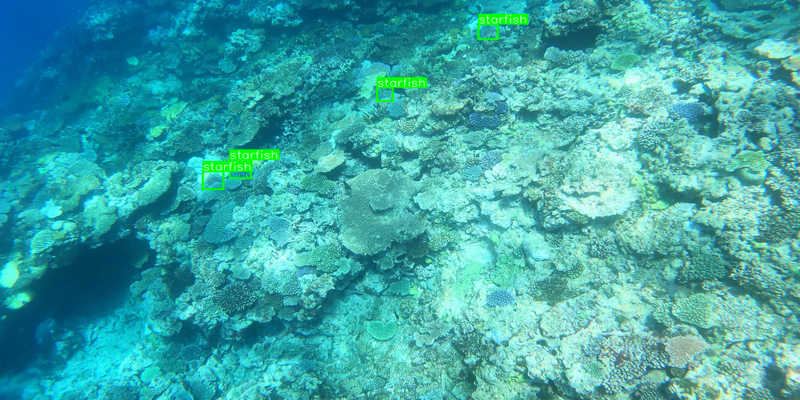

[       0.93        0.93        0.92        0.68]

Model 2 Predictions: 


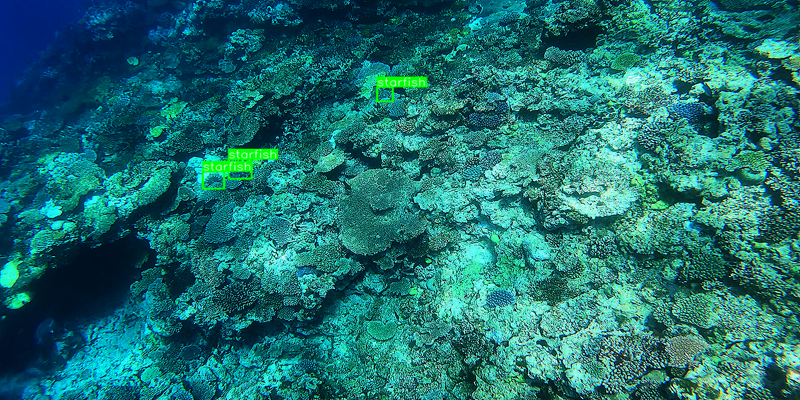

[       0.94         0.9         0.9]

Ensemble (WBF) Predictions: 


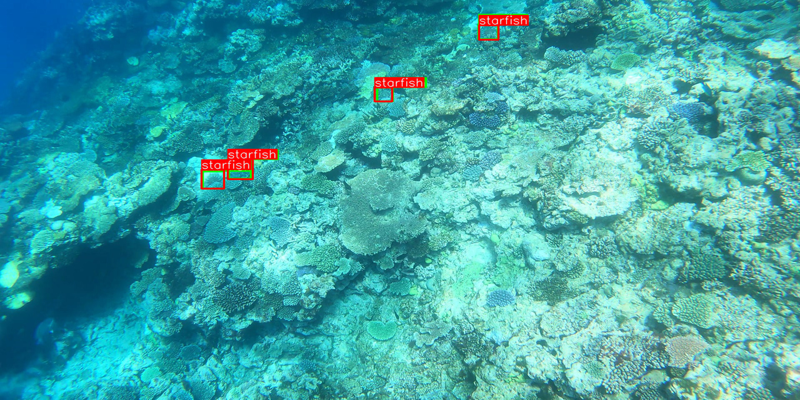

[      0.935       0.915        0.91        0.68]

 Tracking


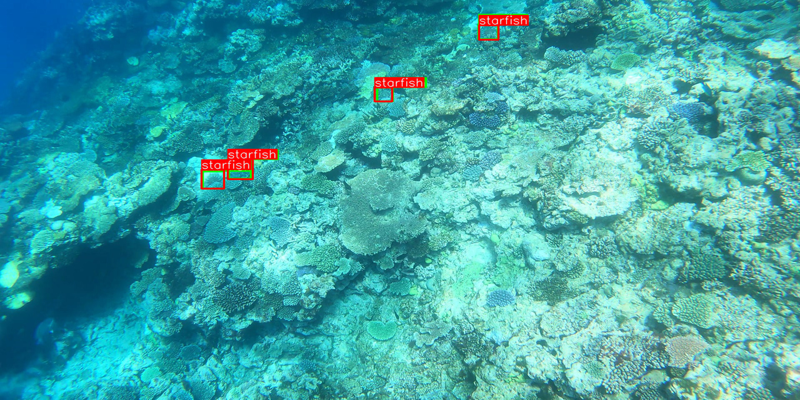

['0.94 324 308 33 31', '0.92 366 286 35 33', '0.91 602 156 24 24', '0.68 765 43 30 27']
--------------------------------------

Model 1 Predictions: 


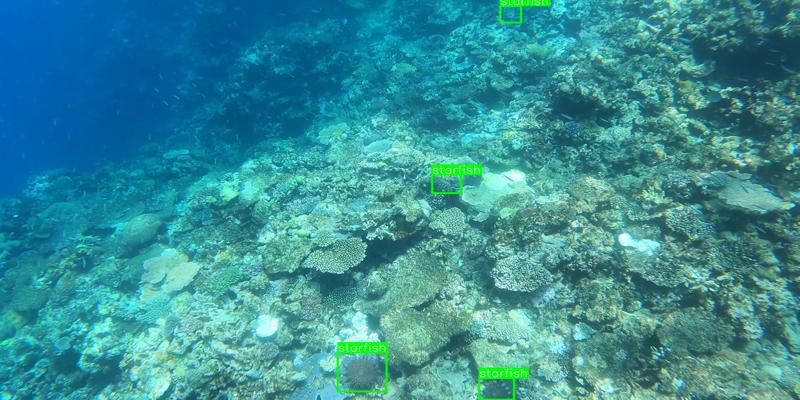

[       0.94        0.89        0.85        0.71]

Model 2 Predictions: 


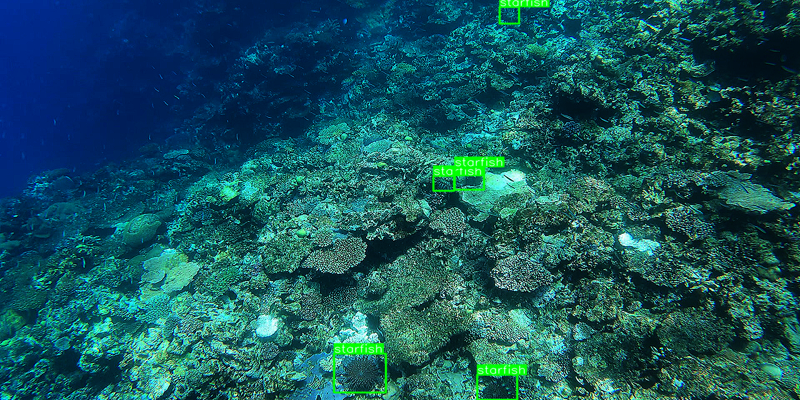

[       0.93        0.93         0.9        0.89        0.66]

Ensemble (WBF) Predictions: 


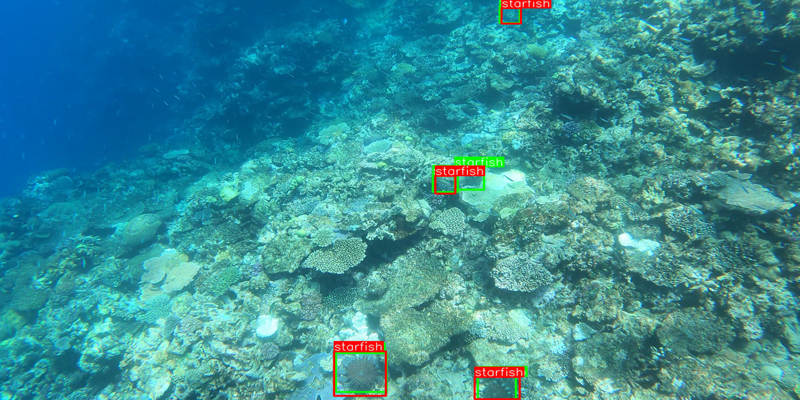

[       0.92        0.91        0.87        0.82        0.66]

 Tracking


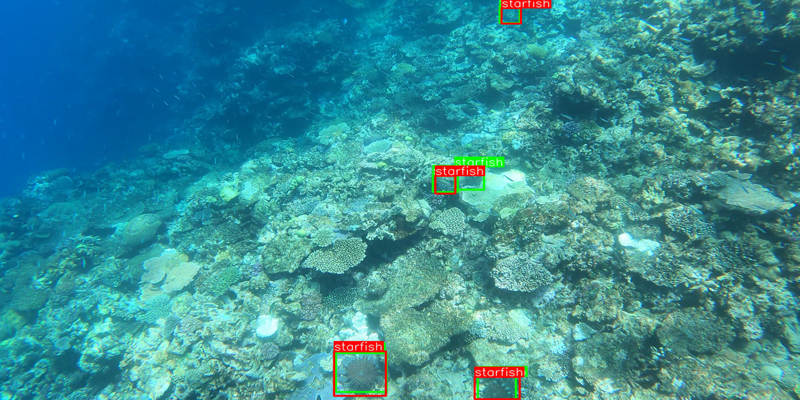

['0.92 691 314 39 30', '0.91 536 635 80 70', '0.87 799 11 31 29', '0.82 764 676 60 42', '0.66 727 300 47 40']
--------------------------------------

Model 1 Predictions: 


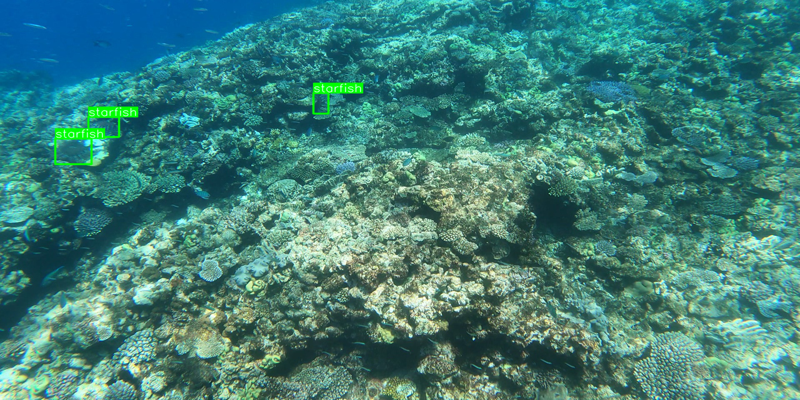

[       0.93        0.93        0.89]

Model 2 Predictions: 


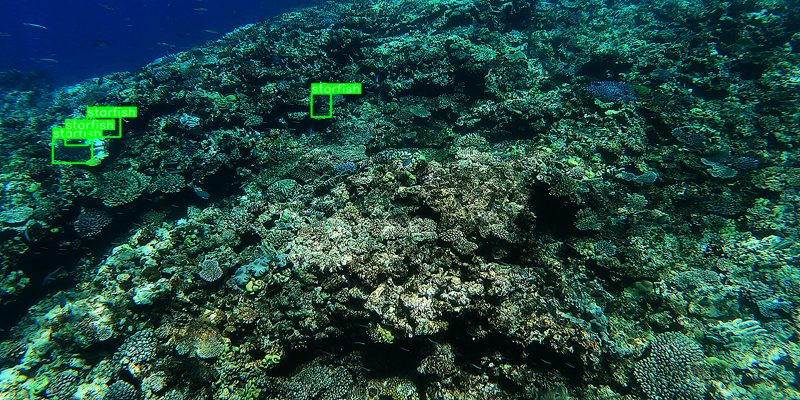

[       0.95        0.93        0.91         0.6]

Ensemble (WBF) Predictions: 


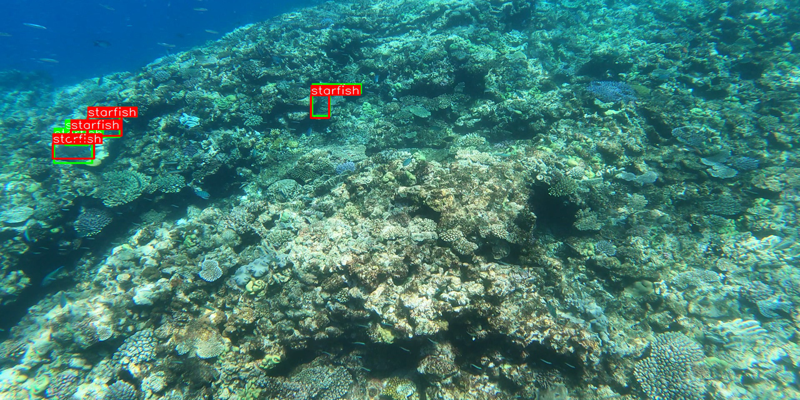

[       0.94        0.92        0.91         0.6]

 Tracking


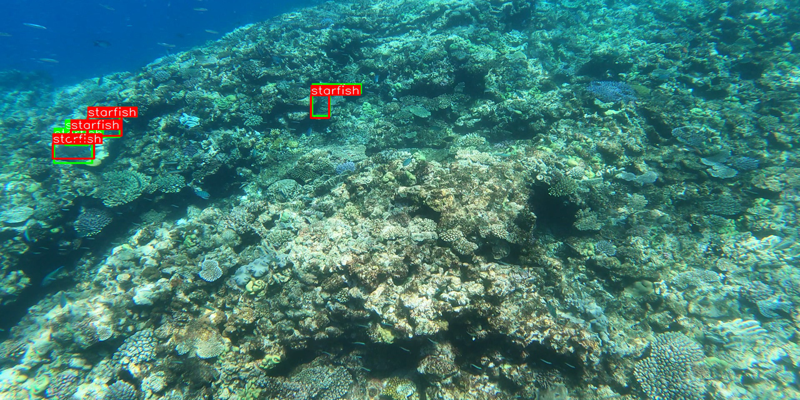

['0.94 85 248 60 45', '0.92 140 210 50 35', '0.91 499 167 27 39', '0.60 104 233 35 27']
--------------------------------------

Model 1 Predictions: 


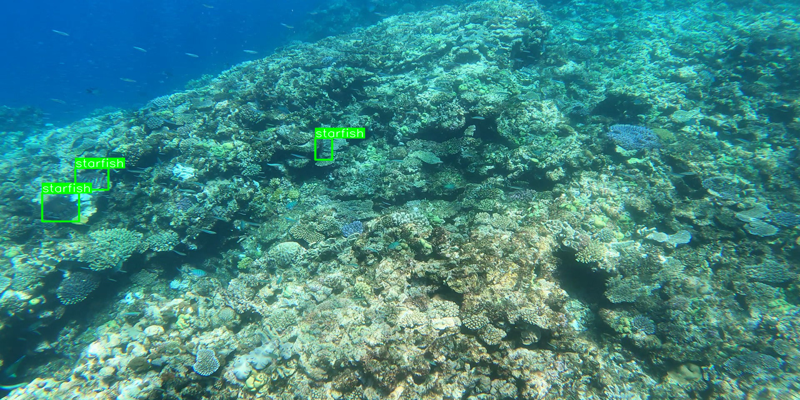

[       0.92        0.91        0.59]

Model 2 Predictions: 


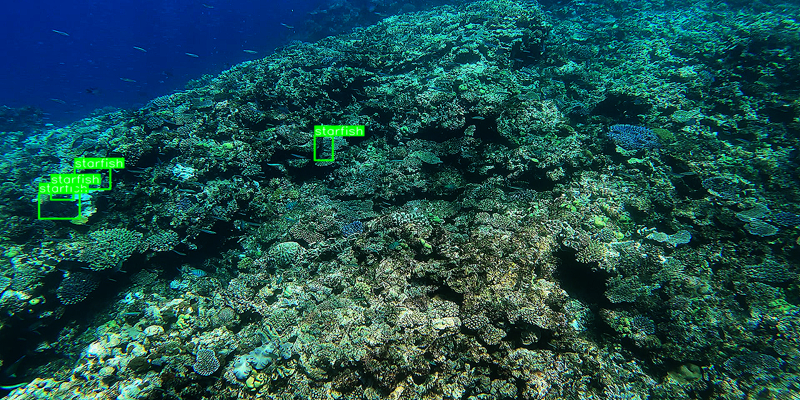

[       0.94        0.93        0.92        0.79]

Ensemble (WBF) Predictions: 


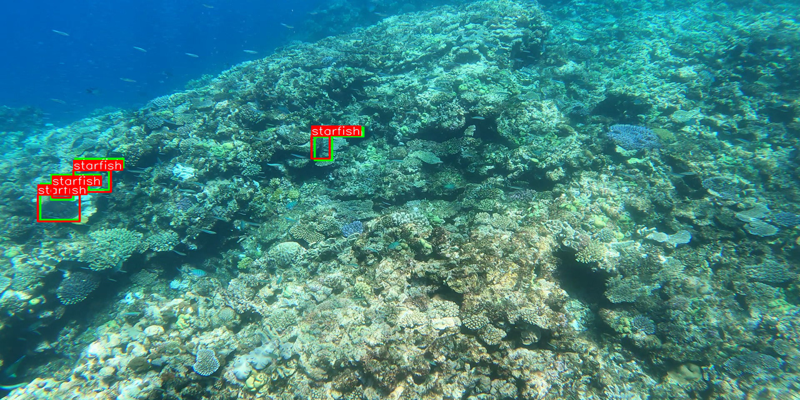

[      0.925        0.92        0.79        0.76]

 Tracking


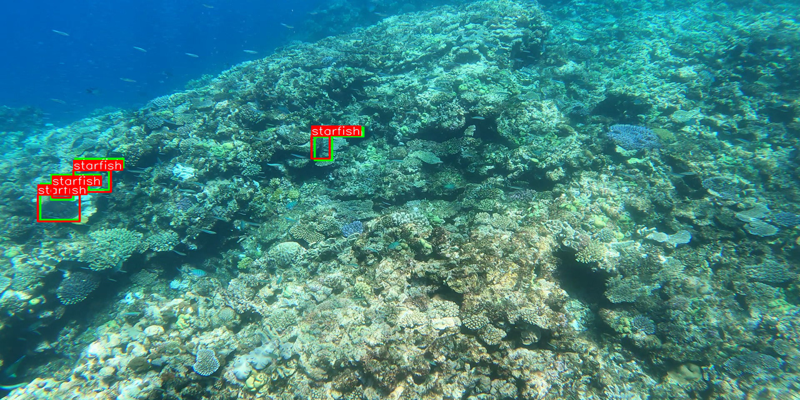

['0.93 503 245 28 41', '0.92 119 301 54 38', '0.79 80 331 36 28', '0.76 63 347 62 47']
--------------------------------------

Model 1 Predictions: 


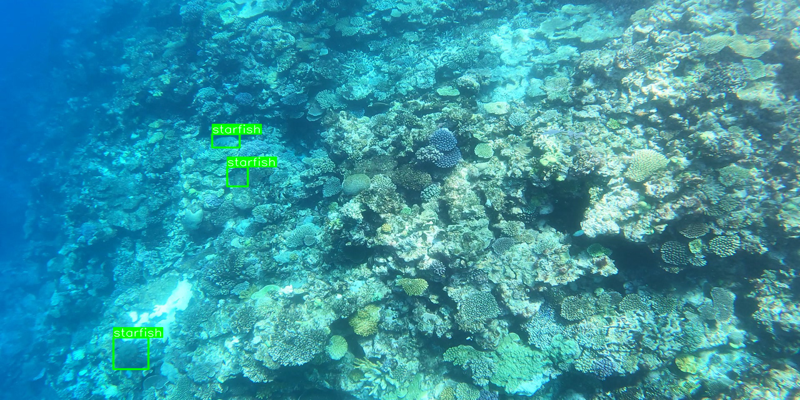

[       0.93        0.93        0.92]

Model 2 Predictions: 


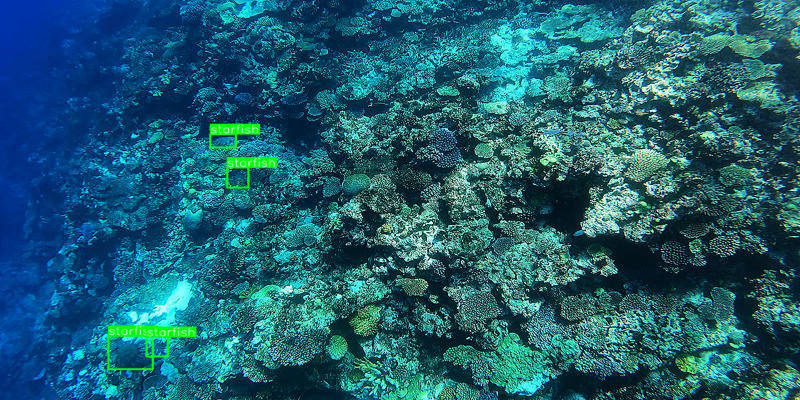

[       0.98        0.94         0.9        0.89]

Ensemble (WBF) Predictions: 


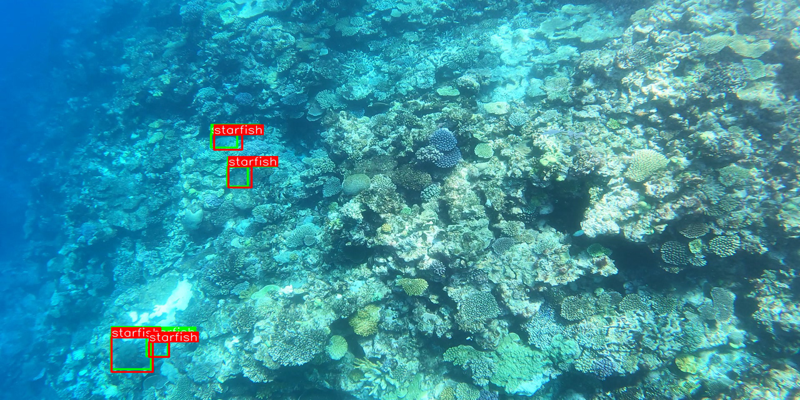

[       0.95       0.935       0.915        0.89]

 Tracking


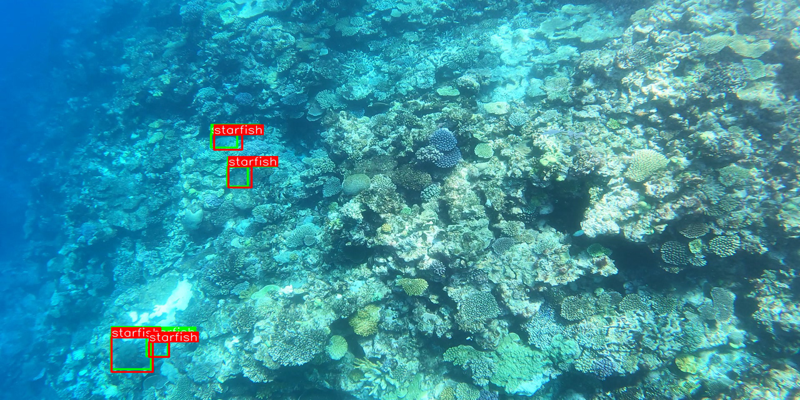

['0.95 337 240 42 23', '0.94 176 605 63 58', '0.92 362 300 33 35', '0.89 234 606 34 34']
--------------------------------------

Model 1 Predictions: 


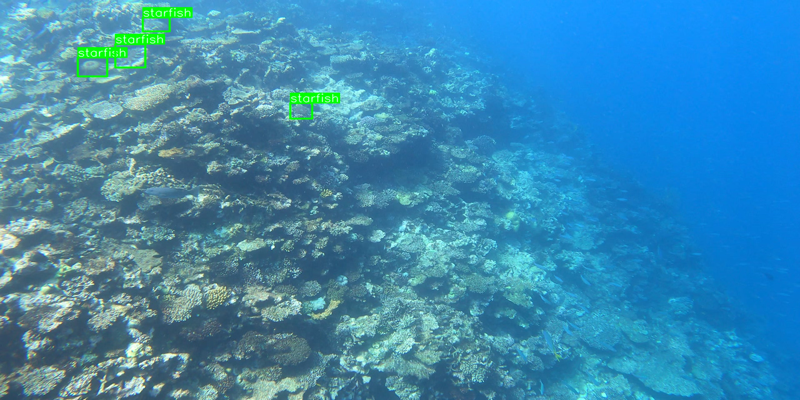

[       0.94        0.92        0.87        0.85]

Model 2 Predictions: 


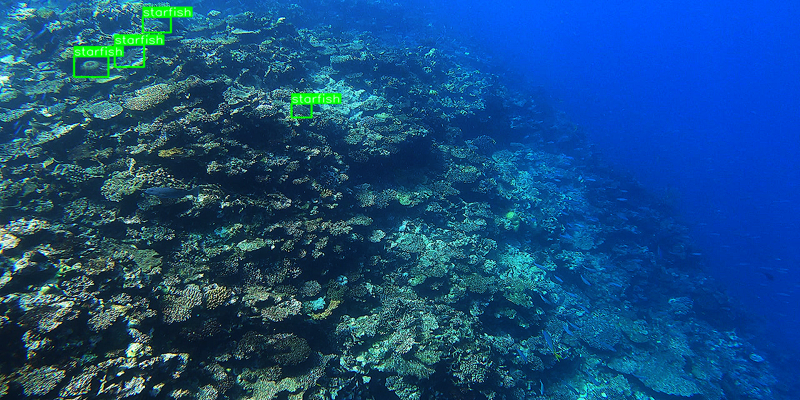

[       0.95        0.93        0.91        0.89]

Ensemble (WBF) Predictions: 


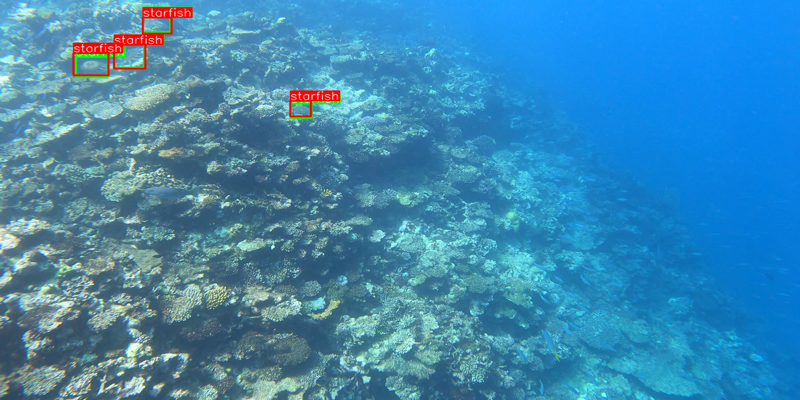

[      0.945       0.925        0.89        0.87]

 Tracking


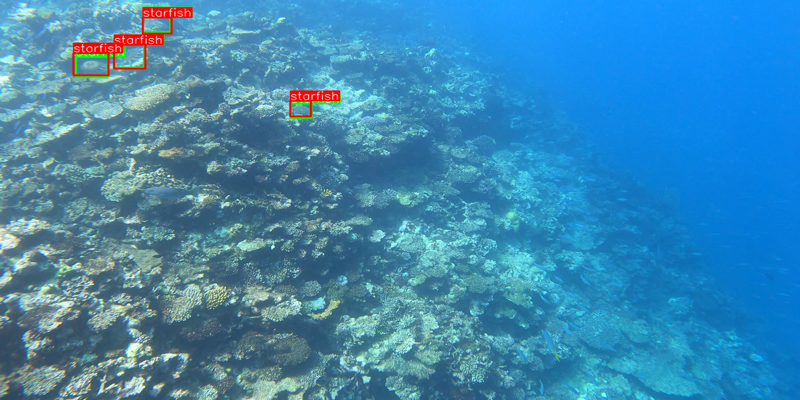

['0.94 120 101 51 35', '0.93 183 79 47 40', '0.89 465 185 33 26', '0.87 228 30 44 26']
--------------------------------------

Model 1 Predictions: 


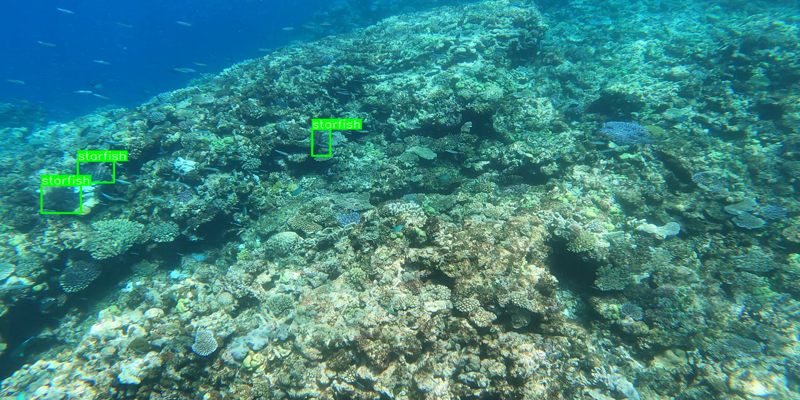

[        0.9        0.65        0.59]

Model 2 Predictions: 


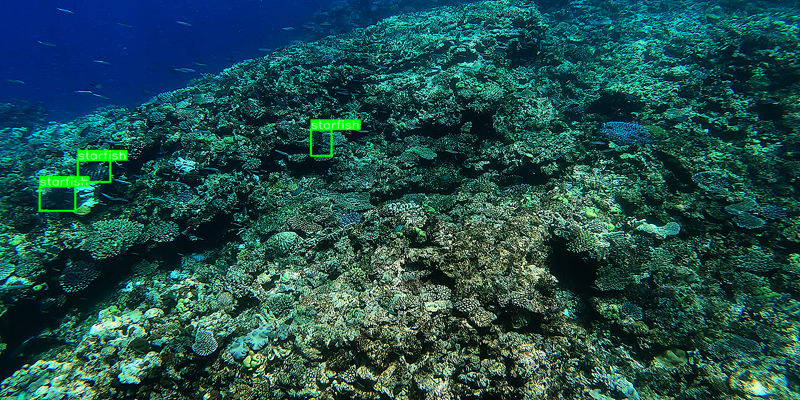

[       0.92        0.91        0.88]

Ensemble (WBF) Predictions: 


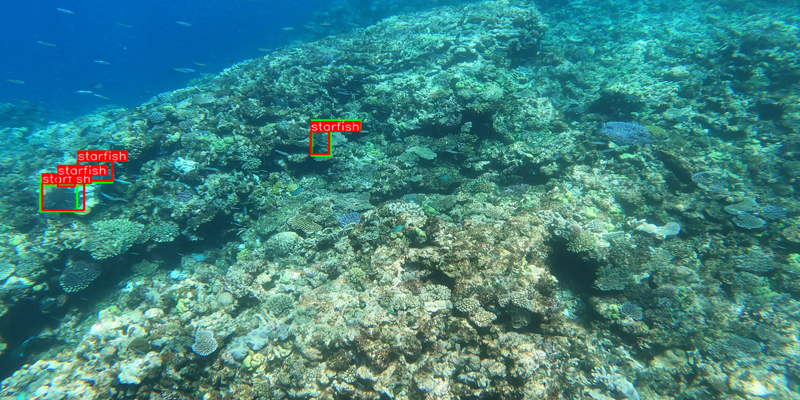

[       0.89        0.78       0.755]

 Tracking


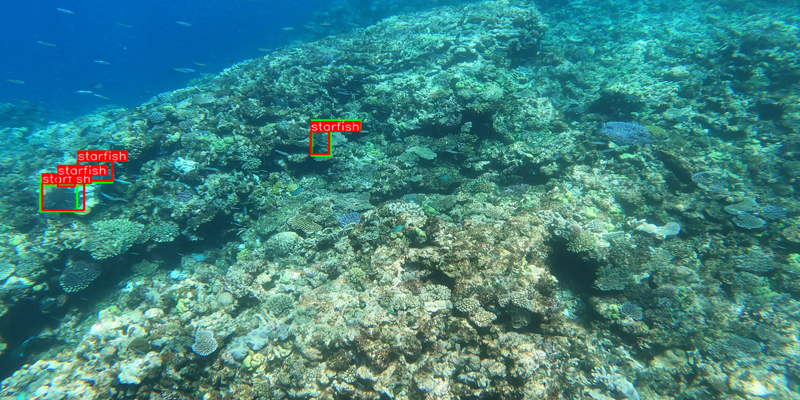

['0.89 124 288 55 38', '0.78 497 232 31 47', '0.75 64 334 59 46']
--------------------------------------


In [115]:
%load_ext autoreload
%autoreload 2

frame_id_1 = 0
frame_id_2 = 0 
frame_id_3 = 0

image_paths = df[df.num_bbox==4].sample(100, random_state=1).image_path.tolist()
for idx, path in enumerate(image_paths):
    img = cv2.imread(path)[...,::-1]
    conf1 = []
    conf2 = []
    tmp1 = []
    tmp2 = []
    
    bboxes_true = [list(box.values()) for box in df[df.image_path == path].annotations.values[0]]
    
    bboxes_1, bboxes_1_wbf, confis_1 = predict(model_1, img, size=IMG_SIZES[0], augment=AUGMENT_1)
    bboxes_2, bboxes_2_wbf, confis_2 = predict_with_preprocess(model_2, img, size=IMG_SIZES[1], augment=AUGMENT_2)
#     print(bboxes_1)
#     print(bboxes_1_wbf)
#     print()
#     print(bboxes_2)
#     print(bboxes_2_wbf)
#     print()
    
    
    pred_1 =  tracking_function(tracker1, frame_id_1, bboxes_1, confis_1)
    pred_2 =  tracking_function(tracker2, frame_id_2, bboxes_2, confis_2)
#     print(pred_1)
#     print(pred_2)

#     print(bboxes_1, bboxes_2)
    
    box1 = [list(map(int,box.split(' ')[1:])) for box in pred_1]
    box2 = [list(map(int,box.split(' ')[1:])) for box in pred_2]
    
    for box in pred_1:
        conf1.append(float(box.split(' ')[0]))
    conf1 = np.asarray(conf1)
    for box in pred_2:
        conf2.append(float(box.split(' ')[0]))
    conf2 = np.asarray(conf2)
#     print(conf1)
#     print(conf2)

    for i in box1:
        a = []
        for j in i :
            a.append(j)
        c = np.asarray(a)
        tmp1.append(c)
    box1 = np.asarray(tmp1)
    
    for i in box2:
        a = []
        for j in i :
            a.append(j)
        c = np.asarray(a)
        tmp2.append(c)
    box2 = np.asarray(tmp2)
    
#     box1 = voc2normalized(coco2voc(box1))
#     box1 = voc2normalized(box1)
    
#     box2 = voc2normalized(coco2voc(box2))
#     box2 = voc2normalized(box2)
#     print(box2)
#     print("END")
#     print([bbox/(IMG_SIZES[i]-1) for (i, bbox) in enumerate([box1,box2])])
#     break
#     print([box1,box2])
#     print("Lengths")
#     print(len(bboxes_1_wbf), len(conf1))
#     print(len(bboxes_2_wbf), len(conf2))
    
    boxes, scores, labels = run_wbf([voc2normalized(coco2voc(box1)),voc2normalized(coco2voc(box2))], [conf1,conf2], image_size=1280)
#     print(len(boxes), len(scores))
#     print("End Lengths")
#     print(boxes)
    predictions = tracking_function(tracker3, frame_id_3, boxes, scores)
    
    print('\nModel 1 Predictions: ')
    display(show_img(img, box1, bbox_format='coco'))
    print(conf1)
    print('\nModel 2 Predictions: ')
    display(show_img(cv2.filter2D(gamma_enhance(img, gamma=2), -1, sharp_filter), box2, bbox_format='coco'))
    print(conf2)
    print('\nEnsemble (WBF) Predictions: ')
    display(show_img(img, boxes, bboxes_true, bbox_format='coco')) #display(show_img(img, boxes, bbox_format='coco'))
    print(scores)
    
    if frame_id_1 < 7:
        if len(predictions)>0:
            box = [list(map(int,box.split(' ')[1:])) for box in predictions]
        else:
            box = []
        print('\n Tracking')
        display(show_img(img, boxes, bboxes_true, bbox_format='coco'))
        print(predictions)
        
    print('--------------------------------------')
    frame_id_1 += 1   
    frame_id_2 += 1
    frame_id_3 += 1
    
    if idx>5:
        break

## Submit Prediction

In [21]:
%cd /kaggle/working/
import greatbarrierreef

env = greatbarrierreef.make_env()   # initialize the environment
iter_test = env.iter_test()

In [22]:
tracker1 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)
tracker2 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)
tracker3 = Tracker(
    distance_function=euclidean_distance, 
    distance_threshold=30,
    hit_inertia_min=3,
    hit_inertia_max=6,
    initialization_delay=1,
)

In [23]:
submission_dict = {
    'id': [],
    'prediction_string': [],
}
frame_id_1 = 0 
frame_id_2 = 0 
frame_id_3 = 0
for idx, (img, pred_df) in enumerate(tqdm(iter_test)):
    
    conf1 = []
    conf2 = []
    tmp1 = []
    tmp2 = []   
    
    bboxes_1, bboxes_1_wbf, confis_1 = predict(model_1, img, size=IMG_SIZES[0], augment=AUGMENT_1)
    bboxes_2, bboxes_2_wbf, confis_2 = predict_with_preprocess(model_2, img, size=IMG_SIZES[1], augment=AUGMENT_2)
#     print(bboxes_1)
#     print(bboxes_2)
    if len(bboxes_1) > 0 and len(bboxes_2) > 0: 
#         bboxes_1, bboxes_2 = voc2coco(bboxes_1.detach().numpy(), image_np.shape[1],image_np.shape[2]).astype(int), bboxes_2
        pred_1 =  tracking_function(tracker1, frame_id_1, bboxes_1, confis_1)
        pred_2 =  tracking_function(tracker2, frame_id_2, bboxes_2, confis_2)

        box1 = [list(map(int,box.split(' ')[1:])) for box in pred_1]
        box2 = [list(map(int,box.split(' ')[1:])) for box in pred_2]


        for box in pred_1:
            conf1.append(float(box.split(' ')[0]))
        conf1 = np.asarray(conf1)
        for box in pred_2:
            conf2.append(float(box.split(' ')[0]))
        conf2 = np.asarray(conf2)
    #     print(conf1)
    #     print(conf2)

        for i in box1:
            a = []
            for j in i :
                a.append(j)
            c = np.asarray(a)
            tmp1.append(c)
        box1 = np.asarray(tmp1)

        for i in box2:
            a = []
            for j in i :
                a.append(j)
            c = np.asarray(a)
            tmp2.append(c)
        box2 = np.asarray(tmp2)
    #     print(box1)
    #     print(box2)

        boxes, scores, labels = run_wbf([voc2normalized(coco2voc(box1)),voc2normalized(coco2voc(box2))], [conf1,conf2], image_size=1280)
#         bboxes, scores, labels = run_wbf([pred_1, pred_2], [scores, confis], image_size = IMG_SIZE)
    elif len(bboxes_1) > 0: bboxes, scores = bboxes_1, confis_1
    elif len(bboxes_2) > 0: bboxes, scores = bboxes_2, confis_2
    else: bboxes = []

    predictions = tracking_function(tracker3, frame_id_3, bboxes, scores)
#     predictions = tracking_function(tracker, frame_id, bboxes, scores)
    
    prediction_str = ' '.join(predictions)
    pred_df['annotations'] = prediction_str
    env.predict(pred_df)
    if frame_id_1 < 3:
        if len(predictions)>0:
            box = [list(map(int,box.split(' ')[1:])) for box in predictions]
        else:
            box = []
        display(show_img(img, box, bbox_format='coco'))
#     print('Prediction:', pred_df)
    frame_id_1 += 1
    frame_id_2 += 1
    frame_id_3 += 1

In [24]:
sub_df = pd.read_csv('submission.csv')
sub_df.head()